In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Dataset link: https://www.kaggle.com/datasets/navoneel/brain-mri-images-for-brain-tumor-detection

In [ ]:
# !unzip "/content/drive/MyDrive/Brain_DataSet.zip" -d"/content/drive/MyDrive/Brain_Dataset"

In [ ]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import glob
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, accuracy_score
import sys
import random
import cv2
from torchsummary import summary

In [ ]:
my_file_y="/content/drive/MyDrive/Brain_Dataset/brain_tumor_dataset/yes/*"
my_file_n="/content/drive/MyDrive/Brain_Dataset/brain_tumor_dataset/no/*"
tumor = []
healthy = []
for f in glob.iglob(my_file_y):      ## it search the specific thing about of the flie like here it search Yes from the file
    img = cv2.imread(f)              ## Read the image
    img = cv2.resize(img,(128,128))  ## resizing the image
    b, g, r = cv2.split(img)         ## Split the RGB channels
    img = cv2.merge([r,g,b])         ## Merge the RGB Channels in right sequence
    tumor.append(img)                ## Append the image in one list

for f in glob.iglob(my_file_n):
    img = cv2.imread(f)
    img = cv2.resize(img,(128,128))
    b, g, r = cv2.split(img)
    img = cv2.merge([r,g,b])
    healthy.append(img)

In [ ]:
healthy = np.array(healthy)      ## Converting into np array
tumor = np.array(tumor)
All = np.concatenate((healthy, tumor))      ## concatenate in one np array

In [1]:
for i in range(len(healthy)):
  plt.imshow(healthy[i])
  plt.show()

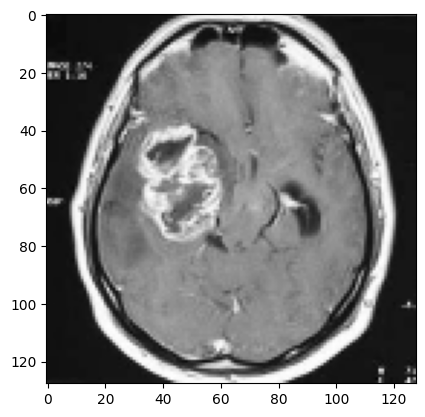

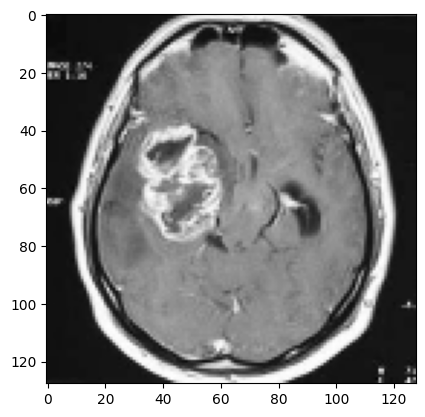

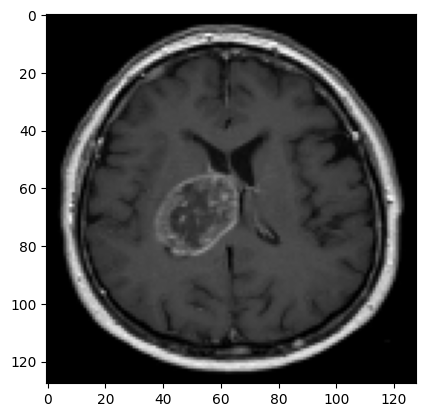

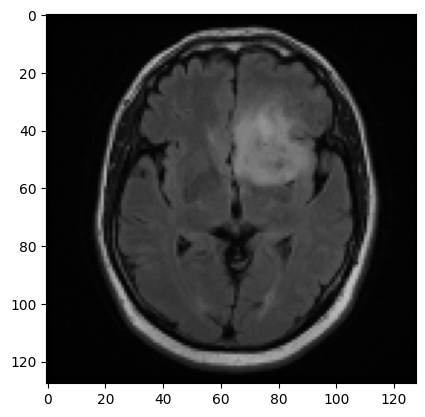

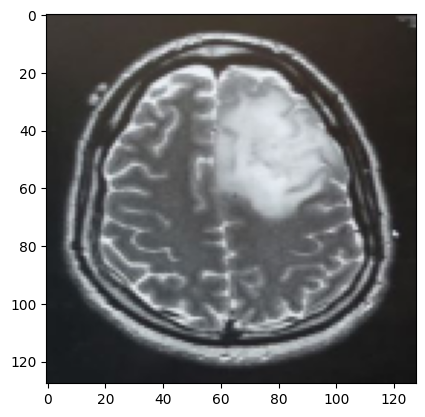

...

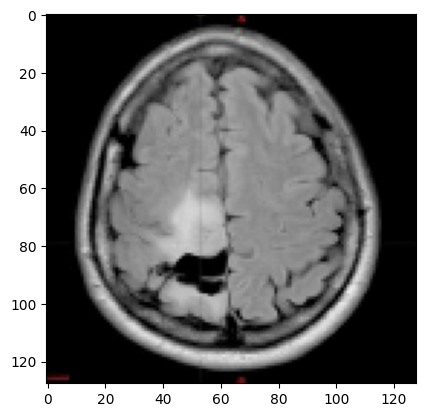

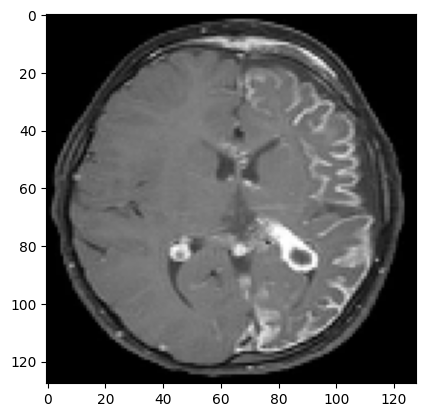

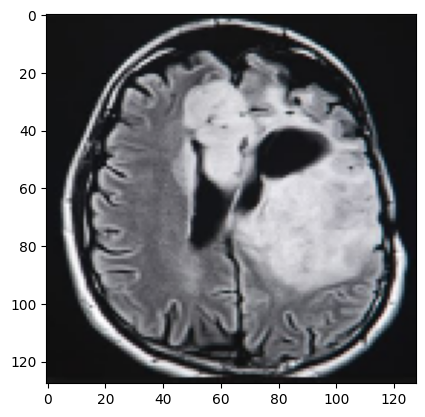

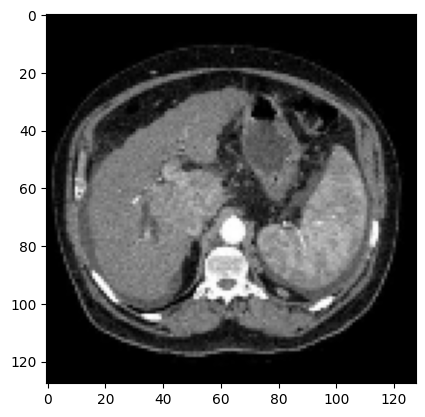

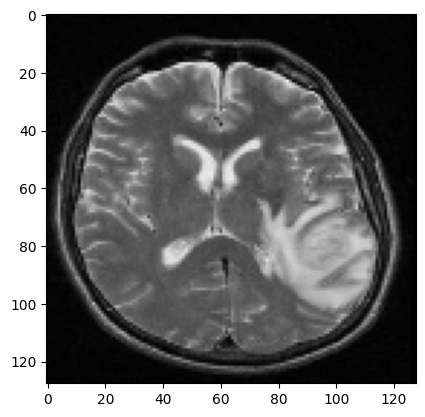

In [ ]:
for i in range(len(tumor)):
  plt.imshow(tumor[i])
  plt.show()

## Ploting the image

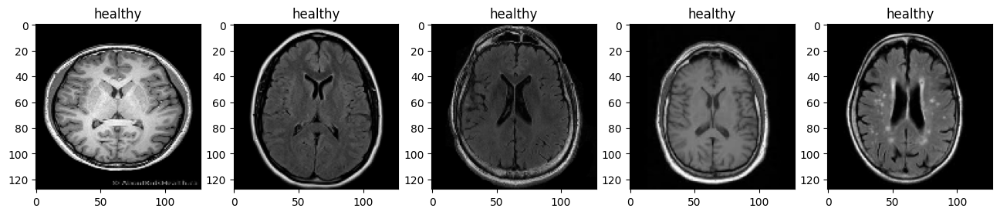

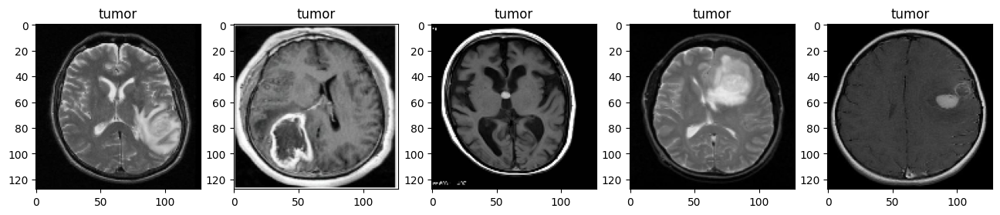

In [ ]:
def plot_random(healthy, tumor, num=5):
    healthy_imgs = healthy[np.random.choice(healthy.shape[0], num, replace=False)]
    tumor_imgs = tumor[np.random.choice(tumor.shape[0], num, replace=False)]

    plt.figure(figsize=(16,9))
    for i in range(num):
        plt.subplot(1, num, i+1)
        plt.title('healthy')
        plt.imshow(healthy_imgs[i])

    plt.figure(figsize=(16,9))
    for i in range(num):
        plt.subplot(1, num, i+1)
        plt.title('tumor')
        plt.imshow(tumor_imgs[i])
plot_random(healthy, tumor, num=5)

## DATASET Classes

In [ ]:
class Dataset(object):
    def __getitem__(self, index):
        raise NotImplementedError

    def __len__(self):
        raise NotImplementedError

    def __add__(self, other):
        return ConcatDataset([self, other])


In [ ]:
class MRI(Dataset):
    def __init__(self):

        tumor = []
        healthy = []
        # cv2 - It reads in BGR format by default
        for f in glob.iglob(my_file_y):
            img = cv2.imread(f)
            img = cv2.resize(img,(128,128)) # I can add this later in the boot-camp for more adventure
            b, g, r = cv2.split(img)
            img = cv2.merge([r,g,b])
            img = img.reshape((img.shape[2],img.shape[0],img.shape[1])) # otherwise the shape will be (h,w,#channels)
            tumor.append(img)

        for f in glob.iglob(my_file_n):
            img = cv2.imread(f)
            img = cv2.resize(img,(128,128))
            b, g, r = cv2.split(img)
            img = cv2.merge([r,g,b])
            img = img.reshape((img.shape[2],img.shape[0],img.shape[1]))
            healthy.append(img)

        # our images
        tumor = np.array(tumor,dtype=np.float32)
        healthy = np.array(healthy,dtype=np.float32)

        # our labels
        tumor_label = np.ones(tumor.shape[0], dtype=np.float32)    # make label of for the dataset
        healthy_label = np.zeros(healthy.shape[0], dtype=np.float32)

        # Concatenates
        self.images = np.concatenate((tumor, healthy), axis=0)
        self.labels = np.concatenate((tumor_label, healthy_label))

    def __len__(self):
        return self.images.shape[0]

    def __getitem__(self, index):                  ## will call that method when you try to access an item using square brackets

        sample = {'image': self.images[index], 'label':self.labels[index]}    ## Create Dictionary Named sample

        return sample

    def normalize(self):
        self.images = self.images/255.0

In [ ]:
mri_dataset = MRI()
mri_dataset.normalize()

1. Creates a mapping between class label (integer) and its readable name.

2. 0 → Healthy, 1 → Tumor.
3. Wraps the mri_dataset using a PyTorch DataLoader so we can load batches.

4. shuffle=True: Mixes the order of the images each time we run it.

5. Changes shape from [C, H, W] to [H, W, C] for matplotlib, which expects
6. images in [height, width, channels].

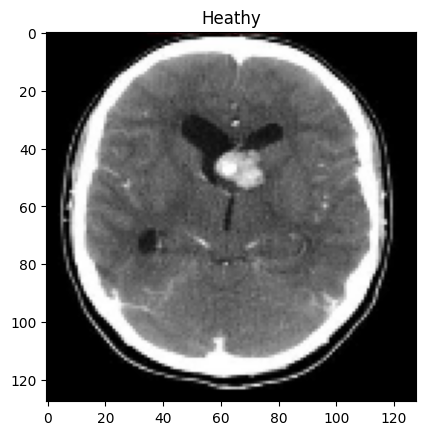

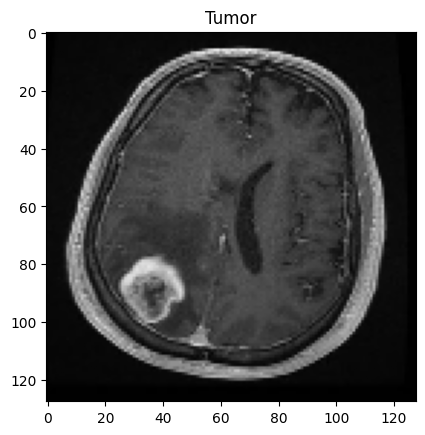

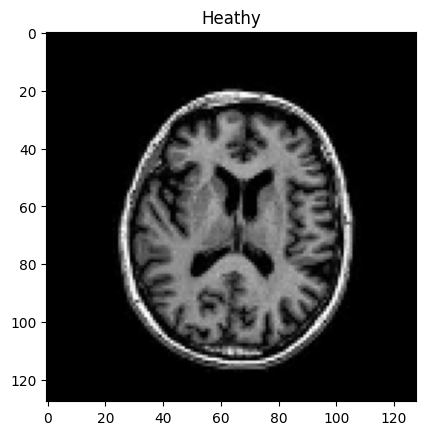

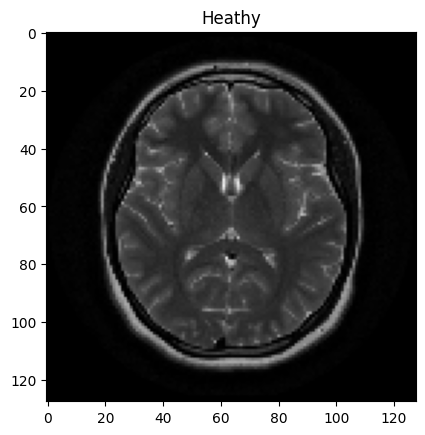

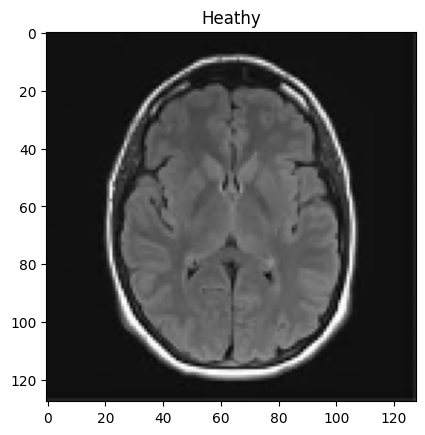

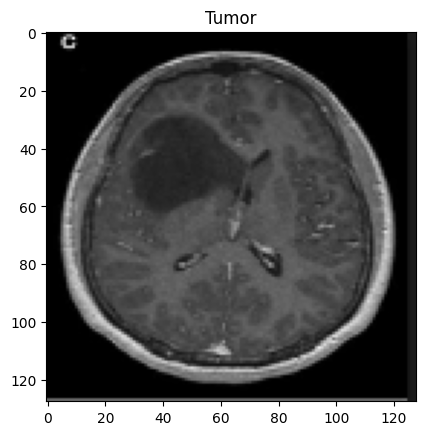

In [ ]:
# One way of iterating
names={0:'Heathy', 1:'Tumor'}
dataloader = DataLoader(mri_dataset, shuffle=True)
for i, sample in enumerate(dataloader):   ## enumerate doing mapping related things
    img = sample['image'].squeeze()       ## if shape of the image [1, 224, 224]  then convert it into [224,224]
    img = img.reshape((img.shape[1], img.shape[2], img.shape[0]))
    plt.title(names[sample['label'].item()])
    plt.imshow(img)
    plt.show()
    if i == 5:
        break

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class CNN(nn.Module):
    def __init__(self):
        super(CNN,self).__init__()
        self.cnn_model = nn.Sequential(
        nn.Conv2d(in_channels=3, out_channels=6, kernel_size=5),
        nn.Tanh(),
        nn.AvgPool2d(kernel_size=2, stride=5),
        nn.Conv2d(in_channels=6, out_channels=16, kernel_size=5),
        nn.Tanh(),
        nn.AvgPool2d(kernel_size=2, stride=5))

        self.fc_model = nn.Sequential(
        nn.Linear(in_features=256, out_features=120),
        nn.Tanh(),
        nn.Linear(in_features=120, out_features=84),
        nn.Tanh(),
        nn.Linear(in_features=84, out_features=1))

    def forward(self, x):
        x = self.cnn_model(x)
        x = x.view(x.size(0), -1)
        x = self.fc_model(x)
        x = F.sigmoid(x)

        return x

## DATALOADER

In [ ]:
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = CNN().to(device)


In [ ]:
model.eval()
outputs = []
y_true = []
with torch.no_grad():
    for D in dataloader:
        image = D['image'].to(device)
        label = D['label'].to(device)

        y_hat = model(image)

        outputs.append(y_hat.cpu().detach().numpy())
        y_true.append(label.cpu().detach().numpy())

In [ ]:
outputs = np.concatenate( outputs, axis=0 ).squeeze()
y_true = np.concatenate( y_true, axis=0 ).squeeze()

In [ ]:
def threshold(scores,threshold=0.50, minimum=0, maximum = 1.0):
    x = np.array(list(scores))
    x[x >= threshold] = maximum
    x[x < threshold] = minimum
    return x

In [ ]:

import numpy as np
from sklearn.metrics import accuracy_score
predicted_classes = (outputs >= 0.5).astype(int) # Applying threshold for binary classification
accuracy = accuracy_score(y_true, predicted_classes)
print(accuracy)

1.0


[Text(0, 0.5, 'Tumor'), Text(0, 1.5, 'Healthy')]

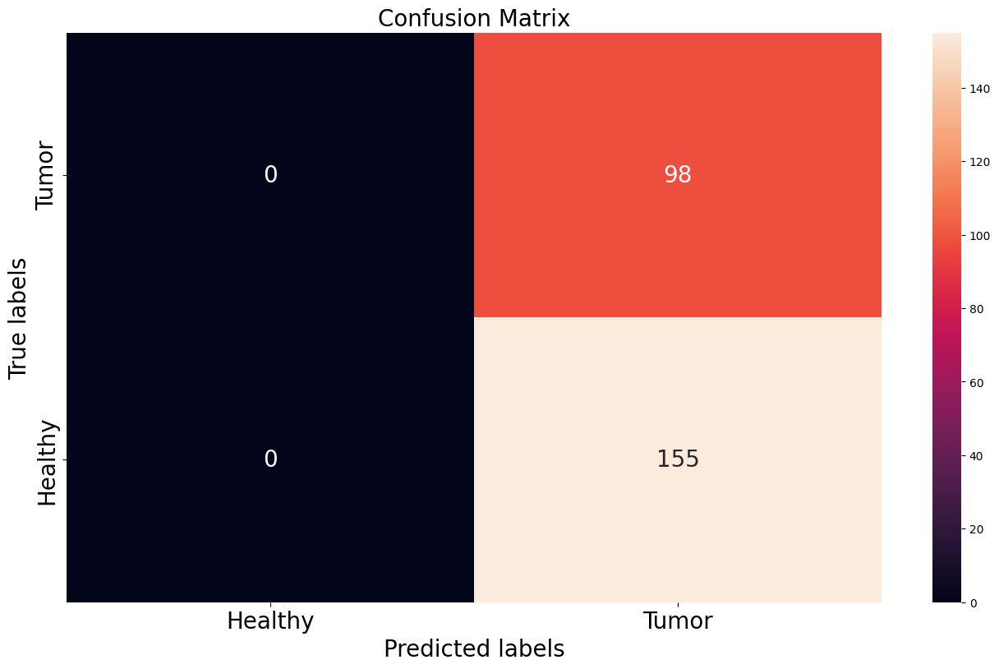

In [ ]:
# a better confusion matrix
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix

plt.figure(figsize=(16,9))
# Assuming 'outputs' contains probabilities for two classes:
#predicted_classes = np.argmax(outputs, axis=1)  # Get predicted class labels (0 or 1) # This line caused the error as 'outputs' is 1D now.
predicted_classes = (outputs >= 0.5).astype(int)  # Directly applying threshold for binary classification
cm = confusion_matrix(y_true, threshold(predicted_classes))  # Use predicted labels
ax= plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax, annot_kws={"size": 20})

# labels, title and ticks
ax.set_xlabel('Predicted labels', fontsize=20)
ax.set_ylabel('True labels', fontsize=20)
ax.set_title('Confusion Matrix', fontsize=20)
ax.xaxis.set_ticklabels(['Healthy','Tumor'], fontsize=20)
ax.yaxis.set_ticklabels(['Tumor','Healthy'], fontsize=20)

In [ ]:
eta = 0.0001
EPOCH = 400
optimizer = torch.optim.Adam(model.parameters(), lr=eta)
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=True)
model.train()

CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [ ]:
for epoch in range(1, EPOCH):
    losses = []
    for D in dataloader:
        optimizer.zero_grad()
        data = D['image'].to(device)
        label = D['label'].to(device)
        y_hat = model(data)
        # define loss function
        error = nn.BCELoss()
        loss = torch.sum(error(y_hat.squeeze(), label))
        loss.backward()
        optimizer.step()
        losses.append(loss.item())
    if (epoch+1) % 10 == 0:
        print('Train Epoch: {}\tLoss: {:.6f}'.format(epoch+1, np.mean(losses)))

Train Epoch: 10	Loss: 0.560815
Train Epoch: 20	Loss: 0.542706
Train Epoch: 30	Loss: 0.528166
Train Epoch: 40	Loss: 0.514293
Train Epoch: 50	Loss: 0.496234
Train Epoch: 60	Loss: 0.472859
Train Epoch: 70	Loss: 0.445985
Train Epoch: 80	Loss: 0.422564
Train Epoch: 90	Loss: 0.399279
Train Epoch: 100	Loss: 0.383658
Train Epoch: 110	Loss: 0.359595
Train Epoch: 120	Loss: 0.339550
Train Epoch: 130	Loss: 0.323386
Train Epoch: 140	Loss: 0.305887
Train Epoch: 150	Loss: 0.280040
Train Epoch: 160	Loss: 0.254197
Train Epoch: 170	Loss: 0.234246
Train Epoch: 180	Loss: 0.211501
Train Epoch: 190	Loss: 0.189334
Train Epoch: 200	Loss: 0.165752
Train Epoch: 210	Loss: 0.144588
Train Epoch: 220	Loss: 0.125811
Train Epoch: 230	Loss: 0.109287
Train Epoch: 240	Loss: 0.089755
Train Epoch: 250	Loss: 0.074512
Train Epoch: 260	Loss: 0.061148
Train Epoch: 270	Loss: 0.048714
Train Epoch: 280	Loss: 0.044100
Train Epoch: 290	Loss: 0.032996
Train Epoch: 300	Loss: 0.026957
Train Epoch: 310	Loss: 0.022148
Train Epoch: 320	

In [ ]:
model.eval()
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)
outputs=[]
y_true = []
with torch.no_grad():
    for D in dataloader:
        image =  D['image'].to(device)
        label = D['label'].to(device)

        y_hat = model(image)

        outputs.append(y_hat.cpu().detach().numpy())
        y_true.append(label.cpu().detach().numpy())

outputs = np.concatenate( outputs, axis=0 )
y_true = np.concatenate( y_true, axis=0 )

In [ ]:
accuracy_score(y_true, threshold(outputs))

1.0

[Text(0, 0.5, 'Tumor'), Text(0, 1.5, 'Healthy')]

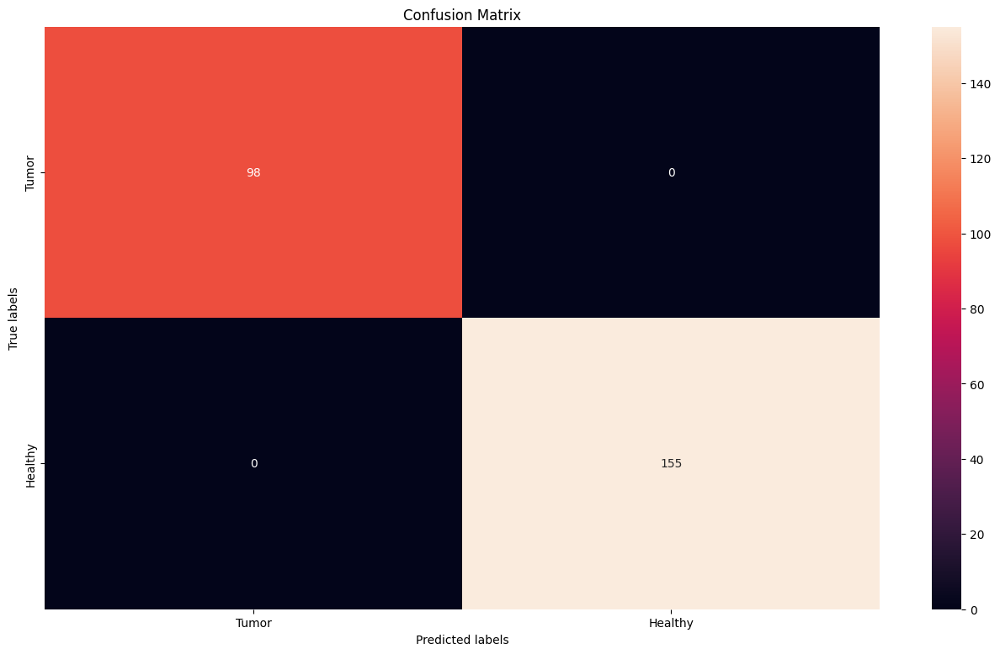

In [ ]:
cm = confusion_matrix(y_true, threshold(outputs))
plt.figure(figsize=(16,9))

ax= plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax);  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.set_title('Confusion Matrix');
ax.xaxis.set_ticklabels(['Tumor','Healthy'])
ax.yaxis.set_ticklabels(['Tumor','Healthy'])

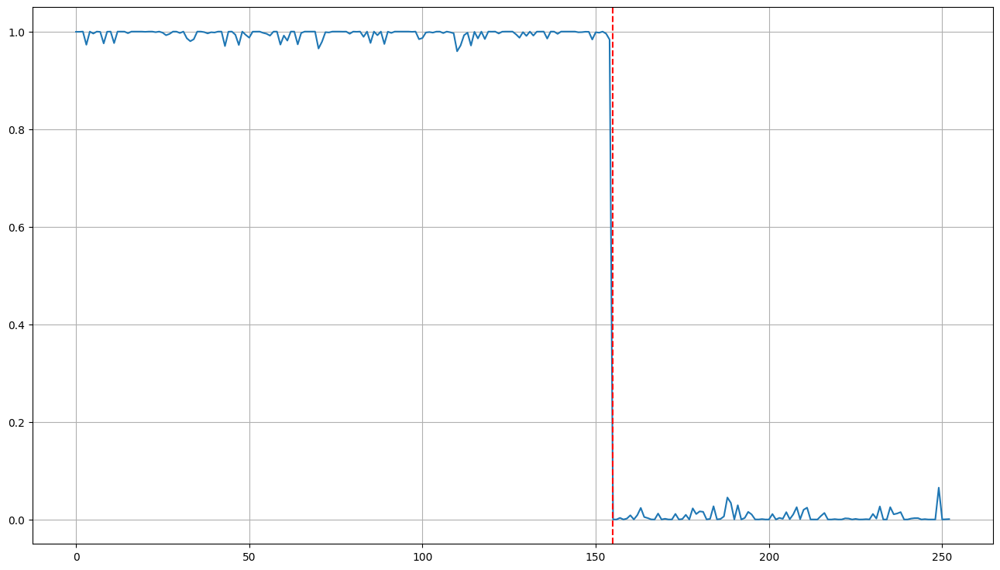

In [ ]:
plt.figure(figsize=(16,9))
plt.plot(outputs)
plt.axvline(x=len(tumor), color='r', linestyle='--')
plt.grid()